In [1]:
import tensorflow as tf
import os
import cv2
import imghdr
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Dropout, Flatten, BatchNormalization, Activation
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras import regularizers
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay

In [2]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [3]:
tf.config.list_physical_devices('CPU')

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]

In [4]:
train_dir = 'Train'
val_dir = 'Validation'
test_dir = 'Test'

In [5]:
image_exts = ['jpeg', 'png', 'jpg', 'tmp']

In [6]:
def removing_unwanted_images(dir):
    for image_class in os.listdir(dir): 
        for image in os.listdir(os.path.join(dir, image_class)):
            image_path = os.path.join(dir, image_class, image)
    
            
            try:
                img = cv2.imread(image_path)
                tip = imghdr.what(image_path)
    
                if tip not in image_exts:
                    return(f'Image not in the existing format {image_path}')
                    os.remove(image_path)
                    
            except Exception as e:
                return(f'Issue with the image {image_path}')
                os.remove(image_path)

In [7]:
removing_unwanted_images(train_dir)
removing_unwanted_images(test_dir)
removing_unwanted_images(val_dir)

In [8]:
image_generator = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)
test_val_gen = ImageDataGenerator(rescale=1./255)

In [9]:
train_data = image_generator.flow_from_directory(
    train_dir,
    target_size = (256, 256),
    batch_size = 64,
    class_mode = 'binary'
)


val_data = test_val_gen.flow_from_directory(
    val_dir,
    target_size = (256, 256),
    batch_size = 64,
    class_mode = 'binary'
)


test_data = test_val_gen.flow_from_directory(
    test_dir,
    target_size = (256, 256),
    batch_size = 64,
    class_mode = 'binary'
)



Found 241 images belonging to 2 classes.
Found 90 images belonging to 2 classes.
Found 20 images belonging to 2 classes.


In [10]:
X_train, y_train = train_data.__next__()
X_val, y_val = val_data.__next__()
X_test, y_test = test_data.__next__()

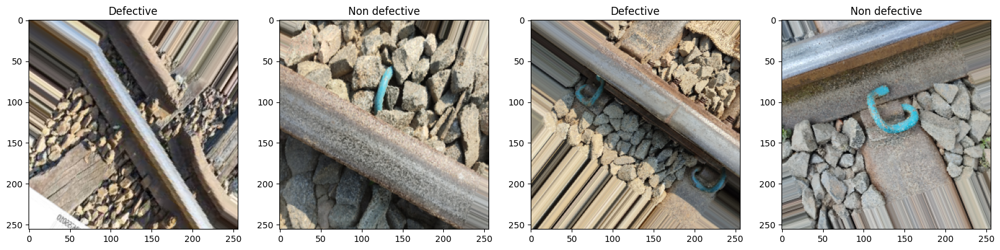

In [11]:
class_indices = train_data.class_indices
class_labels = {v: k for k, v in class_indices.items()}

fig, ax = plt.subplots(ncols=4, figsize=(20, 20))

for idx, img in enumerate(X_train[:4]):
    ax[idx].imshow(img)
    numeric_label = y_train[idx]
    class_name = class_labels[numeric_label]    
    ax[idx].title.set_text(class_name)

plt.show()

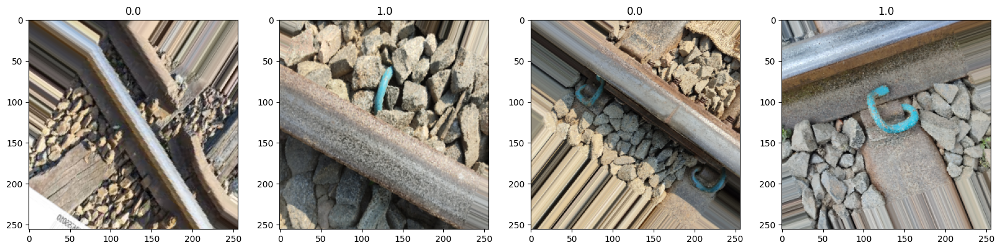

In [12]:
fig, ax = plt.subplots(ncols = 4, figsize=(20, 20))

for idx, img in enumerate(X_train[:4]):
    ax[idx].imshow(img)
    ax[idx].title.set_text(y_train[idx])

In [13]:
print(f'Shape of X_train: {X_train.shape}')
print(f'Shape of y_train: {y_train.shape}')
print('\n')
print(f'Shape of X_val: {X_val.shape}')
print(f'Shape of y_val: {y_val.shape}')

Shape of X_train: (64, 256, 256, 3)
Shape of y_train: (64,)


Shape of X_val: (64, 256, 256, 3)
Shape of y_val: (64,)


In [14]:
train_defective_dir = os.path.join('Train/Defective')
train_nondefective_dir = os.path.join('Train/Non defective')

val_defective_dir = os.path.join('Validation/Defective')
val_nondefective_dir = os.path.join('Validation/Non defective')

In [15]:
ntrain_def_pictures = len(os.listdir(train_defective_dir))
ntrain_nondef_pictures = len(os.listdir(train_nondefective_dir))
print(f'total training defective images : {ntrain_def_pictures}')
print(f'total training non-defective images : {ntrain_nondef_pictures}')


nval_def_images = len(os.listdir(val_defective_dir))
nval_nondef_images = len(os.listdir( val_nondefective_dir))
print(f'total validation defective images : {nval_def_images}')
print(f'total validation non-defective images : {nval_nondef_images}')

total training defective images : 102
total training non-defective images : 139
total validation defective images : 25
total validation non-defective images : 65


There seems to be a bias in our data images towards non-defective.

We adjust class weights to adjust this
$$
w_j = total numberofsamples / (number of classes * Number of samples_j)
$$

***

#### Adjusting class weights

In [16]:
total_images = ntrain_def_pictures + ntrain_nondef_pictures

weight_defective = total_images/(2*ntrain_def_pictures)
weight_nondefective = total_images/(2*ntrain_nondef_pictures)

class_weights= {0: weight_defective, 1: weight_nondefective} # 0 and 1 being the classes for binary classification
print(f'Class weights: {class_weights}')

Class weights: {0: 1.1813725490196079, 1: 0.8669064748201439}


In [17]:
model = Sequential()

In [18]:
model.add(Conv2D(16, (3, 3), 1, activation='relu', input_shape=(256, 256, 3)))
model.add(MaxPooling2D())

model.add(Conv2D(32, (3, 3), 1, activation='relu'))
model.add(MaxPooling2D())

model.add(Conv2D(32, (3, 3), 1, activation='relu'))
model.add(MaxPooling2D())

model.add(Conv2D(64, (3, 3), 1, activation='relu'))
model.add(MaxPooling2D())

model.add(Conv2D(64, (3, 3), 1, activation='relu'))
model.add(MaxPooling2D())

model.add(Flatten())

model.add(Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.0001)))
model.add(Dropout(0.3))

model.add(Dense(1, activation = 'sigmoid'))

/Users/zlorak/anaconda3/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2024-09-15 20:29:42.953123: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M1
2024-09-15 20:29:42.953154: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 8.00 GB
2024-09-15 20:29:42.953157: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 2.67 GB
2024-09-15 20:29:42.954350: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-09-15 20:29:42.954656: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:27

In [19]:
model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=1e-3), loss=tf.losses.BinaryCrossentropy(), metrics=['accuracy'])

In [20]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 254, 254, 16)   │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 127, 127, 16)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 125, 125, 32)   │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 62, 62, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 60, 60, 32)     │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 30, 30, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 28, 28, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 14, 14, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 12, 12, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 6, 6, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 2304)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 660,097 (2.52 MB)

 Trainable params: 660,097 (2.52 MB)

 Non-trainable params: 0 (0.00 B)

In [21]:
hist = model.fit(X_train, y_train, epochs=30, class_weight=class_weights, batch_size=64, validation_data=(X_val, y_val))

Epoch 1/30


2024-09-15 20:29:43.700597: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - accuracy: 0.3750 - loss: 0.7459 - val_accuracy: 0.6719 - val_loss: 0.7082
Epoch 2/30
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step - accuracy: 0.6094 - loss: 0.7333 - val_accuracy: 0.6719 - val_loss: 0.7240
Epoch 3/30
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - accuracy: 0.6094 - loss: 0.7260 - val_accuracy: 0.6562 - val_loss: 0.7289
Epoch 4/30
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step - accuracy: 0.6719 - loss: 0.7221 - val_accuracy: 0.5938 - val_loss: 0.7294
Epoch 5/30
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - accuracy: 0.6562 - loss: 0.7173 - val_accuracy: 0.6250 - val_loss: 0.7230
Epoch 6/30
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step - accuracy: 0.6250 - loss: 0.7156 - val_accuracy: 0.6094 - val_loss: 0.7168
Epoch 7/30
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - accuracy: 0.7031 - loss: 0.6991 - val_accuracy: 0.5000 - val_loss: 0.7248
Epoch 8/30
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step - accuracy: 0.7188 - loss: 0.6753 - val_accuracy: 0.5625 - val_loss: 0.7504
Epoch 

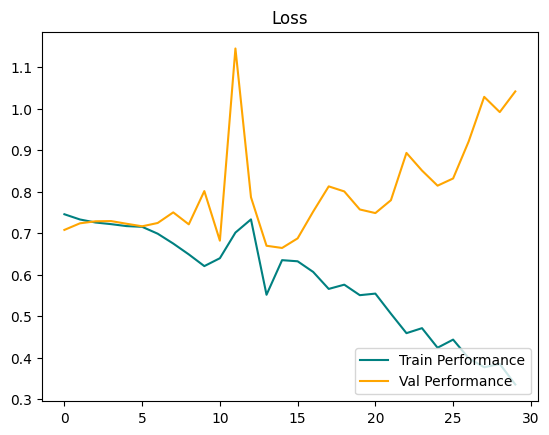

In [22]:
plt.plot(hist.history['loss'], color='teal', label='Train Performance')
plt.plot(hist.history['val_loss'], color='orange', label='Val Performance')
plt.title('Loss')
plt.legend(loc='lower right')
plt.show()

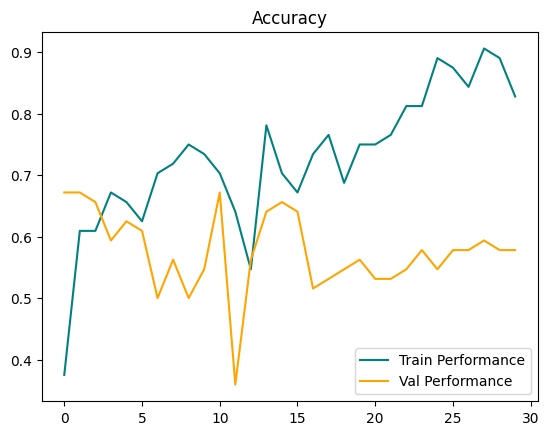

In [23]:
plt.plot(hist.history['accuracy'], color='teal', label='Train Performance')
plt.plot(hist.history['val_accuracy'], color='orange', label='Val Performance')
plt.title('Accuracy')
plt.legend(loc='lower right')
plt.show()

In [24]:
y_pred = model.predict(X_test)

y_pred_binary = (y_pred > 0.5).astype(int)
y_test = np.array(y_test)
y_pred_binary = np.array(y_pred_binary)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


              precision    recall  f1-score   support

         0.0       0.50      0.38      0.43         8
         1.0       0.64      0.75      0.69        12

    accuracy                           0.60        20
   macro avg       0.57      0.56      0.56        20
weighted avg       0.59      0.60      0.59        20



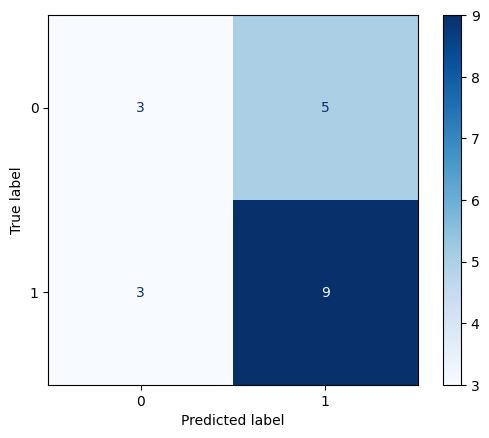

In [25]:
cm = confusion_matrix(y_test, y_pred_binary)
print(classification_report(y_test, y_pred_binary))


disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [26]:
loss, accuracy = model.evaluate(test_data)
print(f'Test accuracy: {accuracy:.2f}')
print(f'Test loss: {loss:.2f}')

/Users/zlorak/anaconda3/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.6000 - loss: 1.0432
Test accuracy: 0.60
Test loss: 1.04


In [73]:
# InceptionV3 model
base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

In [74]:
# Freezing the base model
base_model.trainable = False

# Freeze all layers except the last 6 layers
for layer in base_model.layers[:-6]:
    layer.trainable = False


In [75]:
model = Sequential([
    base_model,
    Flatten(),
    Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.0001)),
    Dropout(0.2),
    Dense(1, activation='sigmoid')
])

In [76]:
model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001), loss=tf.keras.losses.BinaryCrossentropy(), metrics=['accuracy'])

In [77]:
model.summary()

Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ inception_v3 (Functional)       │ (None, 6, 6, 2048)     │    21,802,784 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 73728)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 256)            │    18,874,624 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_7 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 40,677,665 (155.17 MB)

 Trainable params: 18,874,881 (72.00 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

In [78]:
hist = model.fit(
    train_data,
    epochs=30,
    batch_size=64,
    validation_data=val_data,
    class_weight=class_weights
)

Epoch 1/30


2024-09-15 21:05:07.183668: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:05:18.594831: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:05:18.595644: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.5250 - loss: 2.2904WARNING:tensorflow:5 out of the last 68 calls to <function TensorFlowTrainer.make_test_function.<locals>.one_step_on_iterator at 0x55500d990> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


4/4 ━━━━━━━━━━━━━━━━━━━━ 69s 12s/step - accuracy: 0.5221 - loss: 2.3025 - val_accuracy: 0.7111 - val_loss: 0.8312
Epoch 2/30


2024-09-15 21:06:12.086578: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:06:24.977569: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:06:24.978451: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 39s 5s/step - accuracy: 0.6878 - loss: 1.0004 - val_accuracy: 0.3111 - val_loss: 1.1597
Epoch 3/30


2024-09-15 21:06:52.935726: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:07:03.603583: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:07:03.604360: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.5541 - loss: 0.7788 - val_accuracy: 0.7222 - val_loss: 0.6297
Epoch 4/30


2024-09-15 21:07:30.179653: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:07:41.498672: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:07:41.499572: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.7670 - loss: 0.6175 - val_accuracy: 0.6667 - val_loss: 0.6426
Epoch 5/30


2024-09-15 21:08:06.830335: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:08:19.391146: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:08:19.391771: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.7412 - loss: 0.5591 - val_accuracy: 0.7111 - val_loss: 0.6029
Epoch 6/30


2024-09-15 21:08:44.561202: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:08:57.220066: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:08:57.221089: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.7638 - loss: 0.5033 - val_accuracy: 0.7333 - val_loss: 0.5619
Epoch 7/30


2024-09-15 21:09:22.385562: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:09:35.113718: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:09:35.114158: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.7865 - loss: 0.5352 - val_accuracy: 0.6556 - val_loss: 0.6424
Epoch 8/30


2024-09-15 21:10:02.054036: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:10:13.082568: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:10:13.083247: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8244 - loss: 0.4728 - val_accuracy: 0.7556 - val_loss: 0.5419
Epoch 9/30


2024-09-15 21:10:37.937473: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:10:50.910762: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:10:50.911546: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8375 - loss: 0.4402 - val_accuracy: 0.7111 - val_loss: 0.5561
Epoch 10/30


2024-09-15 21:11:15.456752: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:11:28.632650: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:11:28.633215: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.7906 - loss: 0.4652 - val_accuracy: 0.8000 - val_loss: 0.5109
Epoch 11/30


2024-09-15 21:11:55.149485: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:12:06.339666: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:12:06.340272: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8569 - loss: 0.3517 - val_accuracy: 0.8111 - val_loss: 0.5117
Epoch 12/30


2024-09-15 21:12:31.816974: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:12:44.016940: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:12:44.017576: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8135 - loss: 0.4338 - val_accuracy: 0.7222 - val_loss: 0.5332
Epoch 13/30


2024-09-15 21:13:10.615990: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:13:21.731439: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:13:21.731800: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8283 - loss: 0.3896 - val_accuracy: 0.8111 - val_loss: 0.5044
Epoch 14/30


2024-09-15 21:13:46.241740: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:13:59.596551: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:13:59.597236: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8578 - loss: 0.4195 - val_accuracy: 0.7667 - val_loss: 0.5160
Epoch 15/30


2024-09-15 21:14:26.192005: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:14:37.302845: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:14:37.303334: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.7842 - loss: 0.4573 - val_accuracy: 0.8556 - val_loss: 0.4860
Epoch 16/30


2024-09-15 21:15:02.679977: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:15:15.332895: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:15:15.333670: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8759 - loss: 0.3732 - val_accuracy: 0.8333 - val_loss: 0.4826
Epoch 17/30


2024-09-15 21:15:41.869921: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:15:53.246307: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:15:53.247173: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8918 - loss: 0.3799 - val_accuracy: 0.8000 - val_loss: 0.4811
Epoch 18/30


2024-09-15 21:16:18.460128: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:16:30.997080: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:16:30.998253: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8550 - loss: 0.3704 - val_accuracy: 0.8222 - val_loss: 0.4617
Epoch 19/30


2024-09-15 21:16:57.769905: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:17:08.764649: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:17:08.765371: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8519 - loss: 0.3509 - val_accuracy: 0.8000 - val_loss: 0.4642
Epoch 20/30


2024-09-15 21:17:34.242994: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:17:46.488204: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:17:46.488694: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8668 - loss: 0.3509 - val_accuracy: 0.8444 - val_loss: 0.4575
Epoch 21/30


2024-09-15 21:18:10.582316: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:18:24.080480: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:18:24.081080: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8440 - loss: 0.3830 - val_accuracy: 0.7889 - val_loss: 0.4834
Epoch 22/30


2024-09-15 21:18:49.268973: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:19:01.667220: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:19:01.667798: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8667 - loss: 0.3311 - val_accuracy: 0.8444 - val_loss: 0.4616
Epoch 23/30


2024-09-15 21:19:28.096023: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:19:39.349046: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:19:39.349589: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8857 - loss: 0.3347 - val_accuracy: 0.8000 - val_loss: 0.4803
Epoch 24/30


2024-09-15 21:20:05.784823: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:20:17.452368: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:20:17.453111: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8775 - loss: 0.3283 - val_accuracy: 0.8111 - val_loss: 0.4696
Epoch 25/30


2024-09-15 21:20:42.145111: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:20:55.096974: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:20:55.097718: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.9382 - loss: 0.2985 - val_accuracy: 0.8111 - val_loss: 0.4850
Epoch 26/30


2024-09-15 21:21:19.622747: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:21:33.121036: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:21:33.122309: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8919 - loss: 0.2955 - val_accuracy: 0.7889 - val_loss: 0.4987
Epoch 27/30


2024-09-15 21:22:00.029000: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:22:10.819958: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:22:10.820498: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8586 - loss: 0.3150 - val_accuracy: 0.7778 - val_loss: 0.5476
Epoch 28/30


2024-09-15 21:22:37.067828: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:22:48.587553: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:22:48.588490: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8748 - loss: 0.3234 - val_accuracy: 0.8000 - val_loss: 0.5013
Epoch 29/30


2024-09-15 21:23:13.373682: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:23:26.247674: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:23:26.248111: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 37s 4s/step - accuracy: 0.8919 - loss: 0.3128 - val_accuracy: 0.8111 - val_loss: 0.4873
Epoch 30/30


2024-09-15 21:23:51.490313: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 2 of 8
2024-09-15 21:24:03.748206: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:582: Filling up shuffle buffer (this may take a while): 4 of 8
2024-09-15 21:24:03.748722: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 4s/step - accuracy: 0.8912 - loss: 0.3067 - val_accuracy: 0.8222 - val_loss: 0.4956


In [79]:
# TESTING MODEL ACCURACY

loss, accuracy = model.evaluate(test_data)
print(f"Test accuracy: {accuracy:.2f}")
print(f'Test loss: {loss:.2f}')

1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step - accuracy: 0.8000 - loss: 0.5042
Test accuracy: 0.80
Test loss: 0.50


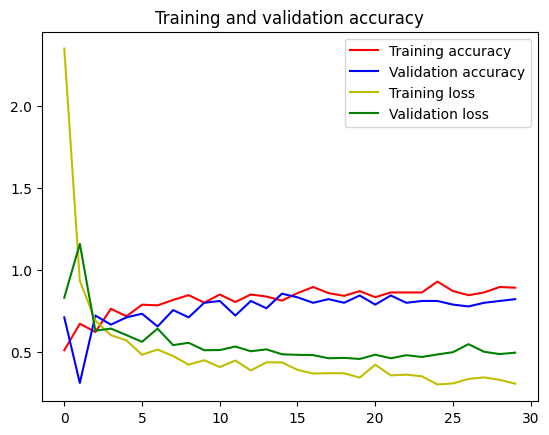

In [80]:
# PLOTTING ACCURACY vs VAL_ACCURACY and LOSS vs VAL_LOSS
plt.plot(hist.history['accuracy'], 'r', label='Training accuracy')
plt.plot(hist.history['val_accuracy'], 'b', label='Validation accuracy')

plt.plot(hist.history['loss'], 'y', label='Training loss')
plt.plot(hist.history['val_loss'], 'g', label='Validation loss')

plt.title('Training and validation accuracy')
plt.legend(loc=0)
plt.show()

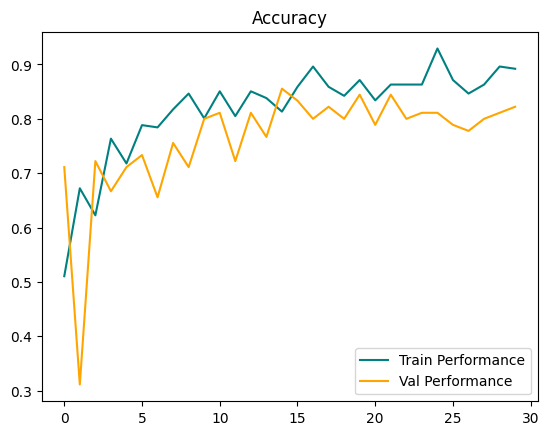

In [81]:
fig = plt.figure()

plt.plot(hist.history['accuracy'], color='teal', label='Train Performance')
plt.plot(hist.history['val_accuracy'], color='orange', label='Val Performance')
plt.title('Accuracy')
plt.legend(loc='lower right')
plt.show()

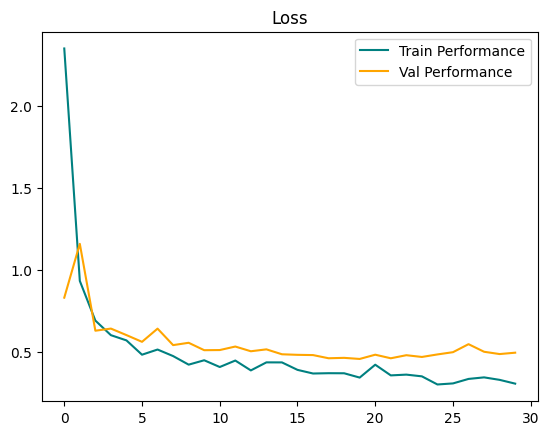

In [82]:
fig = plt.figure()

plt.plot(hist.history['loss'], color='teal', label='Train Performance')
plt.plot(hist.history['val_loss'], color='orange', label='Val Performance')
plt.title('Loss')
plt.legend(loc='upper right')
plt.show()

In [83]:
y_pred = model.predict(X_test)

y_pred_binary = (y_pred > 0.5).astype(int)
y_test = np.array(y_test)
y_pred_binary = np.array(y_pred_binary)

1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


              precision    recall  f1-score   support

         0.0       0.70      0.88      0.78         8
         1.0       0.90      0.75      0.82        12

    accuracy                           0.80        20
   macro avg       0.80      0.81      0.80        20
weighted avg       0.82      0.80      0.80        20



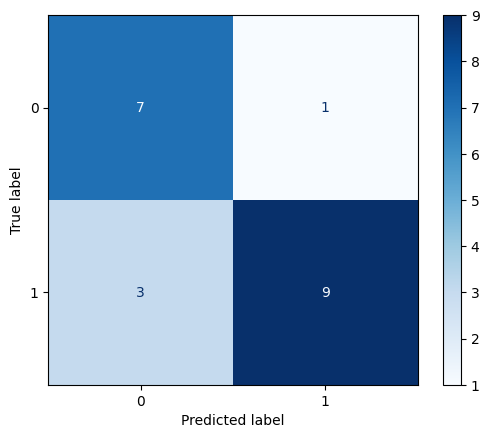

In [84]:
cm = confusion_matrix(y_test, y_pred_binary)
print(classification_report(y_test, y_pred_binary))


disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [85]:
def testing(img_dir):
    img = cv2.imread(img_dir)
    print('Original image')
    plt.imshow(img)
    plt.show()

    resize = tf.image.resize(img, (256, 256))
    print('Rescaled image')
    plt.imshow(resize.numpy().astype(int))
    plt.show()

    yhat = model.predict(np.expand_dims(resize/255, 0))

    if yhat > 0.5:
        print('Predicted value: Non Defective')
    else:
        print('Predicted value: Defective')

    print(f'Actual value: {os.path.dirname(img_dir)[5:]}')
    print('\n')
    print('\n')

In [86]:
image_paths = []
for image_class in os.listdir('Test'):
    for image in os.listdir(os.path.join('Test', image_class)):
        image_path = os.path.join('Test', image_class, image)

        print(image_path)
        image_paths.append(image_path)

Test/Defective/IMG_20201114_102222.jpg
Test/Defective/IMG_20201114_103110.jpg
Test/Defective/IMG_20201114_100209.jpg
Test/Defective/IMG_20201114_101200.jpg
Test/Defective/IMG_20201114_100159.jpg
Test/Defective/IMG_20201114_102203.jpg
Test/Defective/IMG_20201114_101124.jpg
Test/Defective/IMG_20201114_102819.jpg
Test/Non defective/IMG_20201114_100344.jpg
Test/Non defective/IMG_20201114_102431.jpg
Test/Non defective/IMG_20201114_100023.jpg
Test/Non defective/IMG_20201114_103013.jpg
Test/Non defective/IMG_20201114_102253.jpg
Test/Non defective/IMG_20201114_102909.jpg
Test/Non defective/IMG_20201114_101756.jpg
Test/Non defective/IMG_20201114_102710.jpg
Test/Non defective/IMG_20201114_101633.jpg
Test/Non defective/IMG_20201114_101907.jpg
Test/Non defective/IMG_20201114_100358.jpg
Test/Non defective/IMG_20201114_102945.jpg


Original image


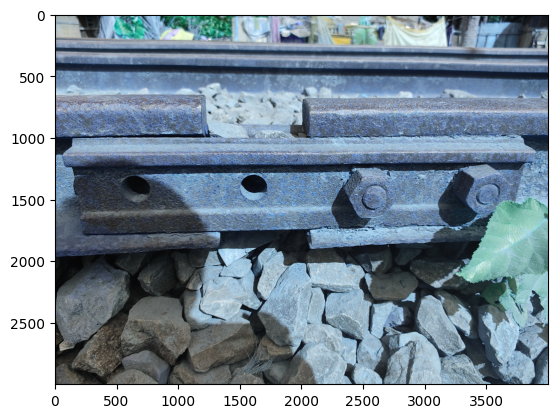

Rescaled image


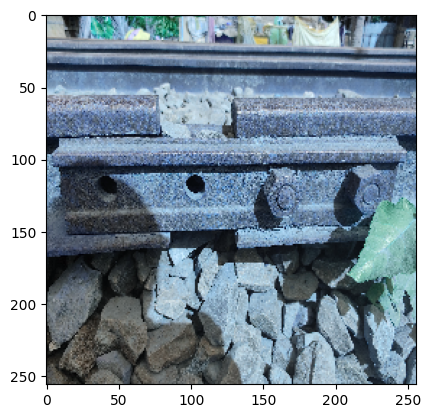

1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
Predicted value: Defective
Actual value: Defective




Original image


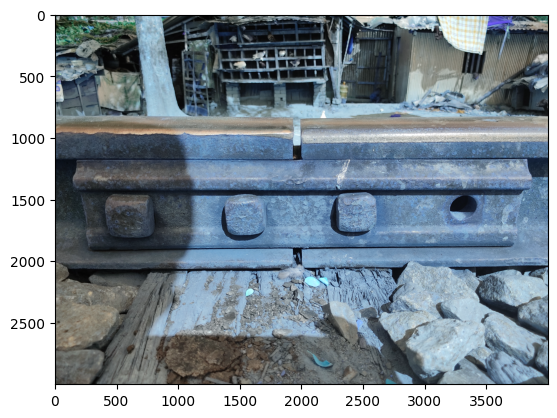

Rescaled image


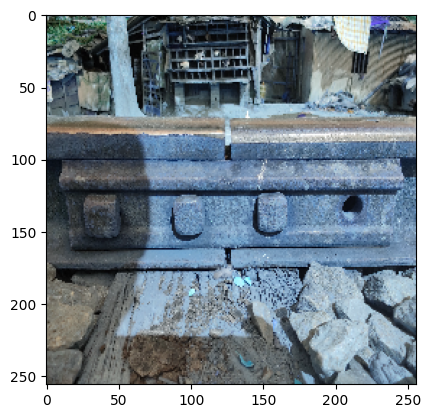

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
Predicted value: Non Defective
Actual value: Defective




Original image


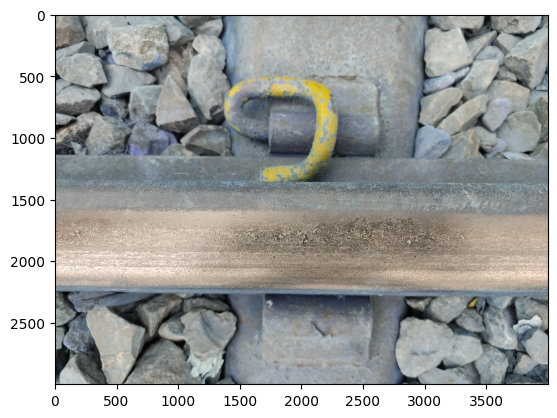

Rescaled image


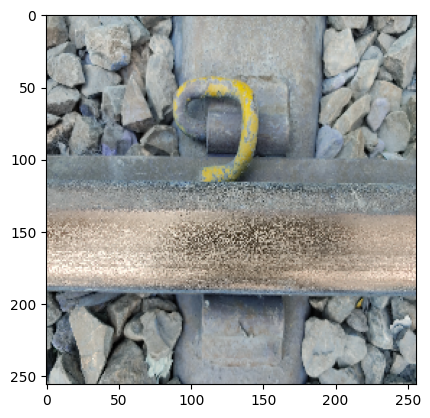

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Predicted value: Non Defective
Actual value: Defective




Original image


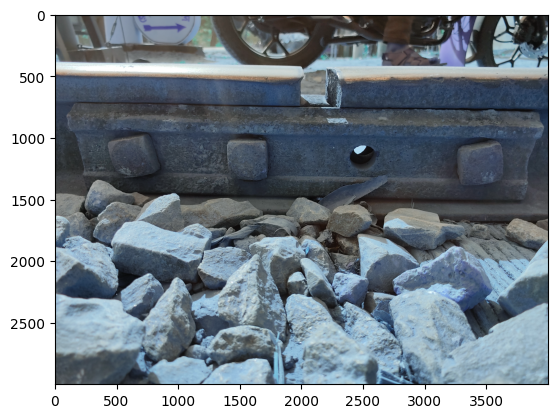

Rescaled image


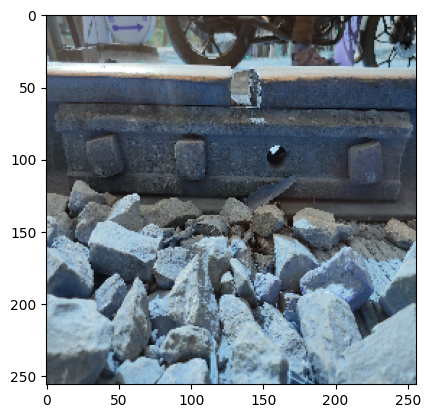

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Predicted value: Defective
Actual value: Defective




Original image


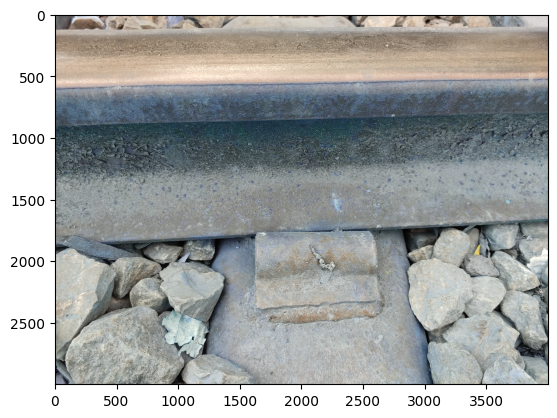

Rescaled image


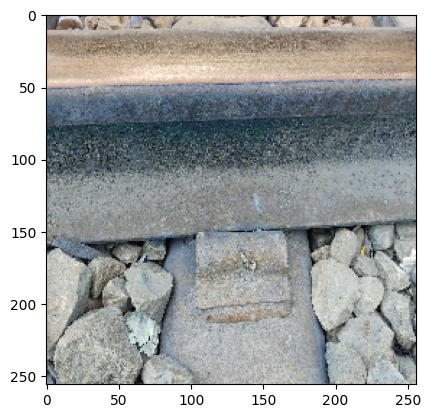

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step
Predicted value: Defective
Actual value: Defective




Original image


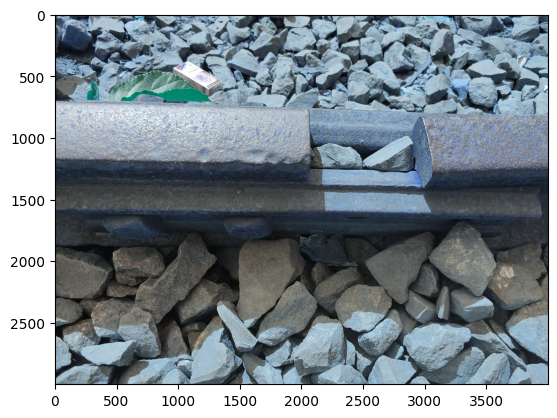

Rescaled image


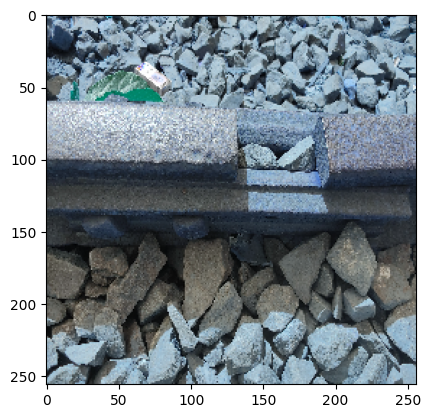

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Predicted value: Defective
Actual value: Defective




Original image


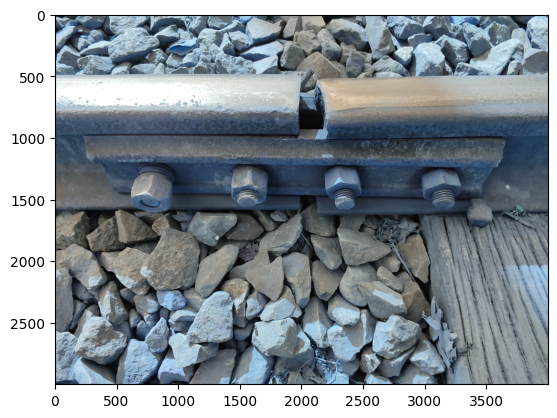

Rescaled image


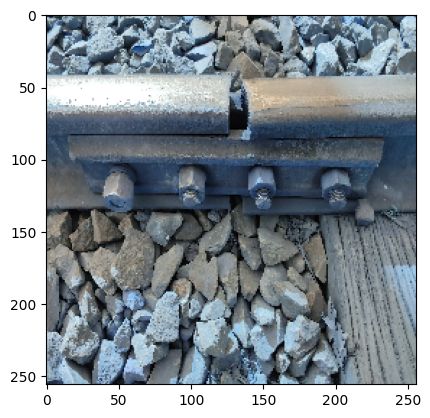

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Predicted value: Non Defective
Actual value: Defective




Original image


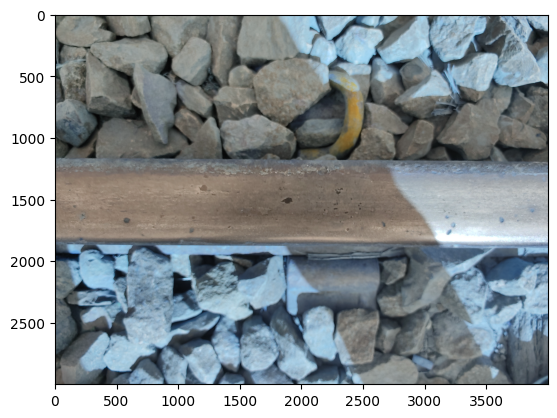

Rescaled image


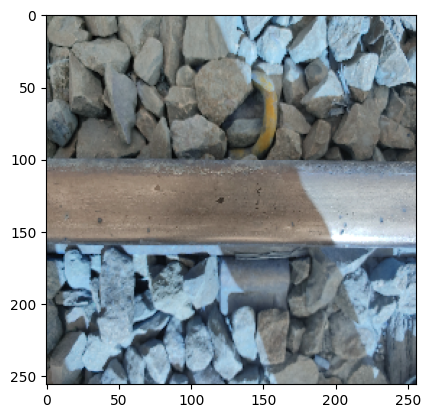

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Predicted value: Non Defective
Actual value: Defective




Original image


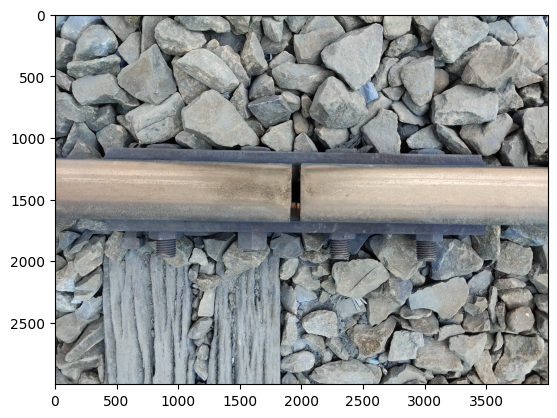

Rescaled image


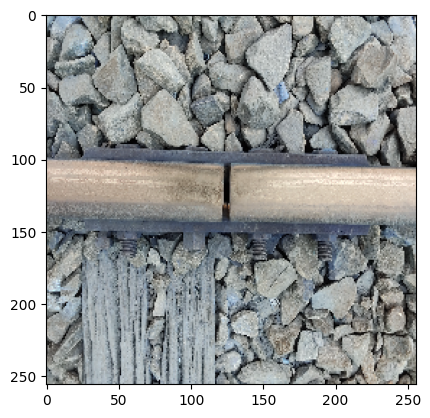

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Predicted value: Non Defective
Actual value: Non defective




Original image


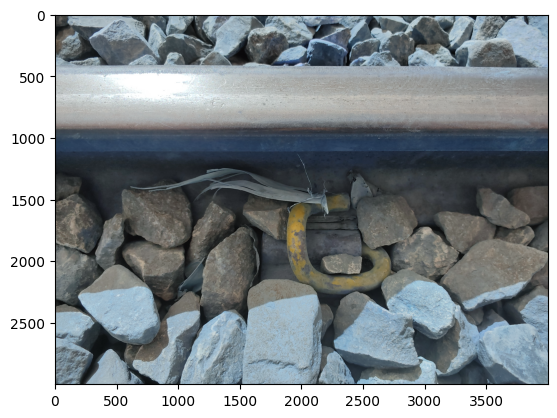

Rescaled image


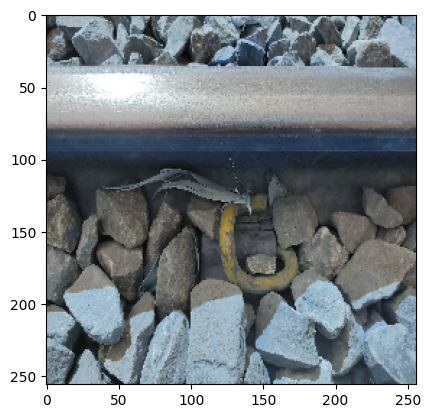

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Predicted value: Non Defective
Actual value: Non defective




Original image


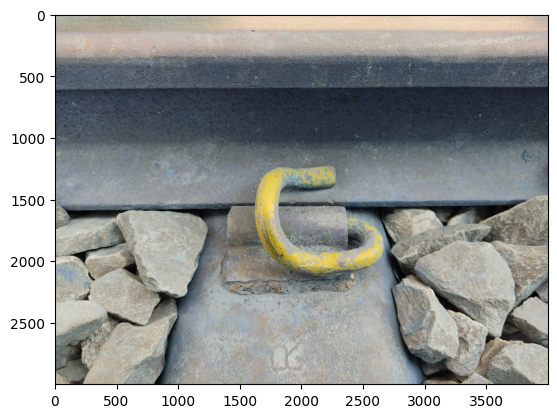

Rescaled image


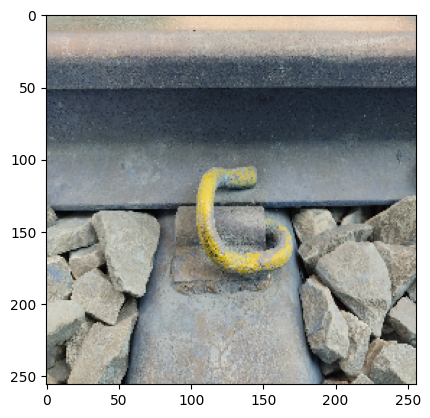

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Predicted value: Non Defective
Actual value: Non defective




Original image


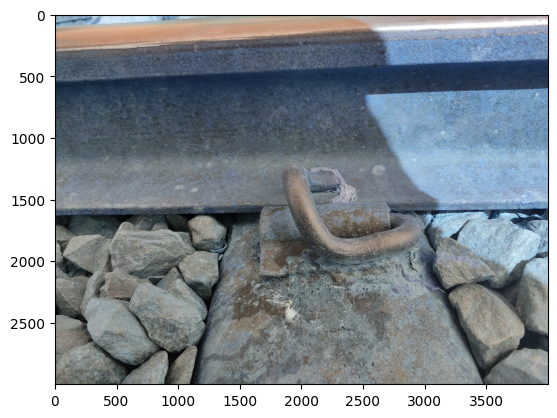

Rescaled image


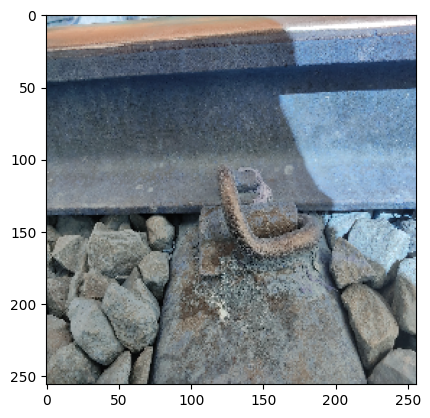

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Predicted value: Defective
Actual value: Non defective




Original image


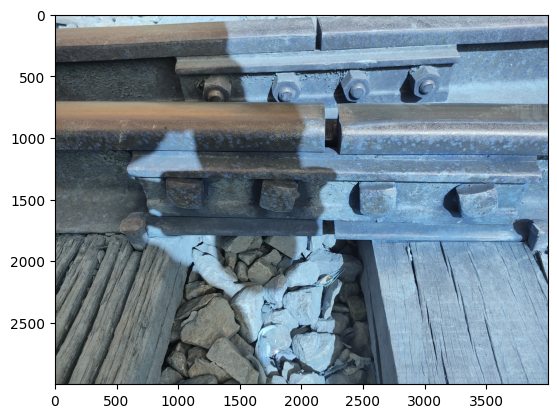

Rescaled image


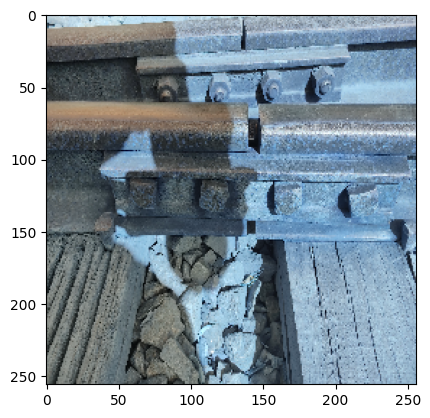

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Predicted value: Defective
Actual value: Non defective




Original image


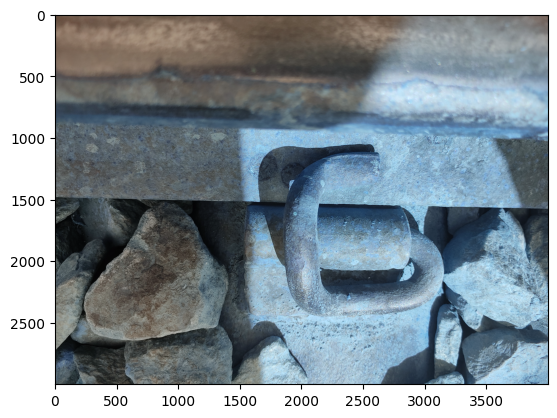

Rescaled image


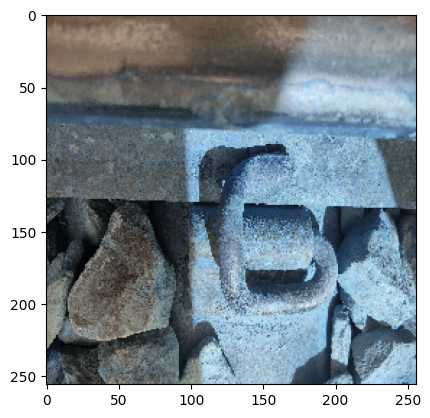

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Predicted value: Non Defective
Actual value: Non defective




Original image


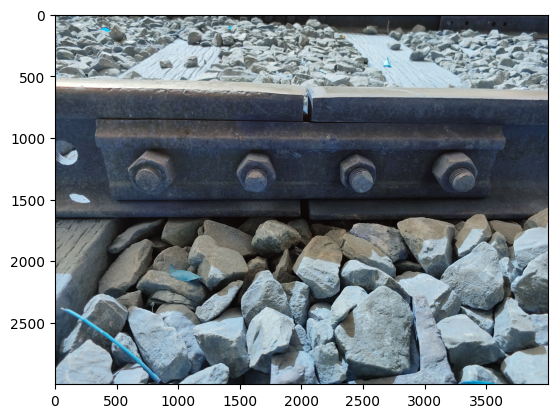

Rescaled image


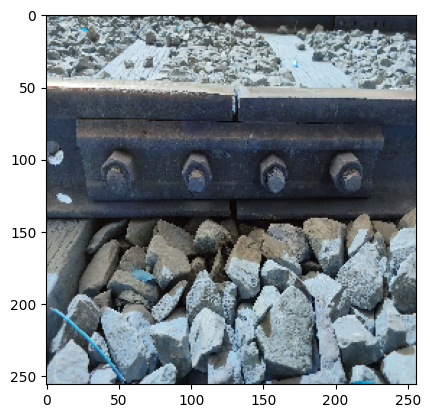

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Predicted value: Defective
Actual value: Non defective




Original image


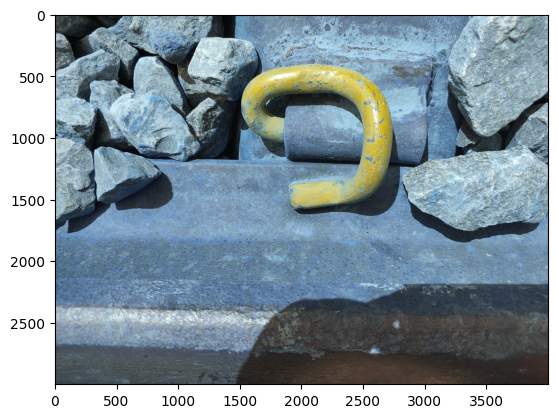

Rescaled image


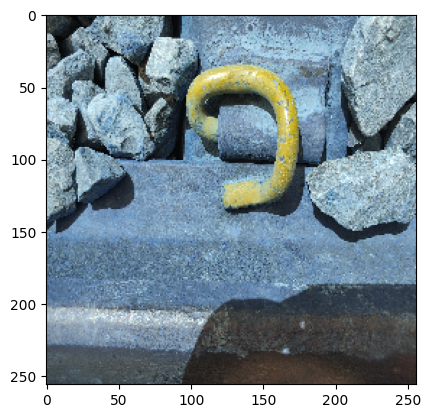

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Predicted value: Non Defective
Actual value: Non defective




Original image


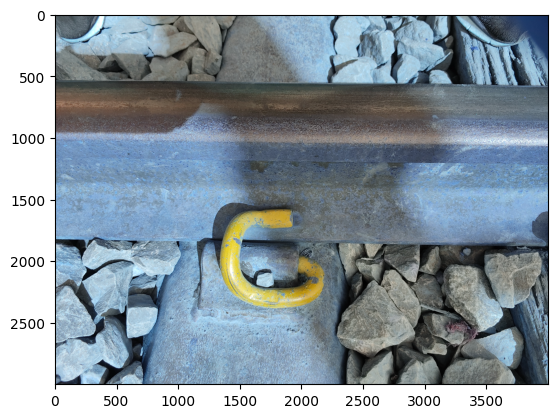

Rescaled image


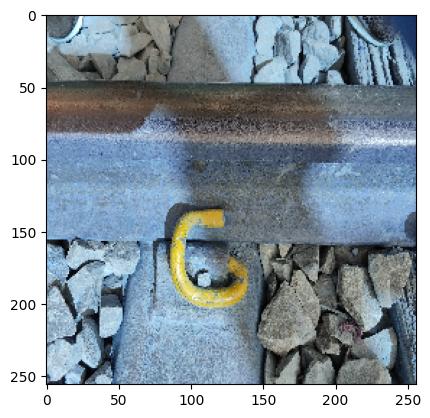

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Predicted value: Non Defective
Actual value: Non defective




Original image


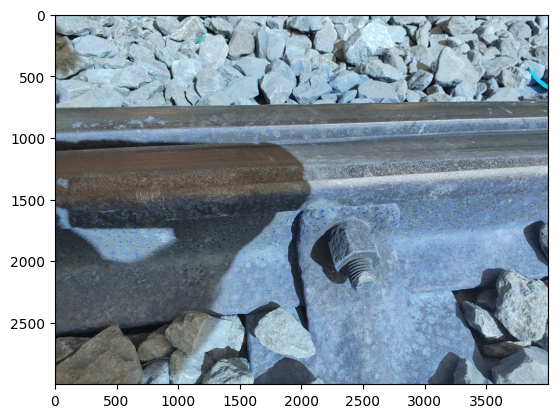

Rescaled image


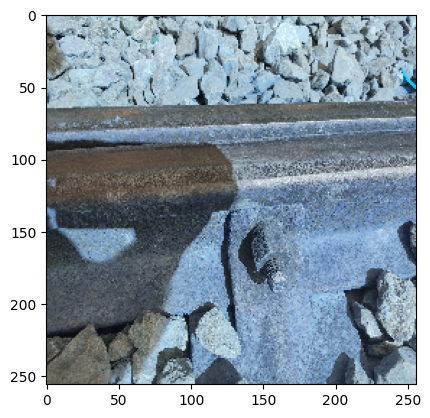

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Predicted value: Non Defective
Actual value: Non defective




Original image


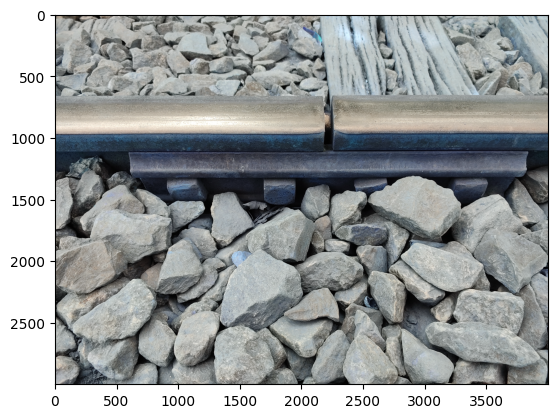

Rescaled image


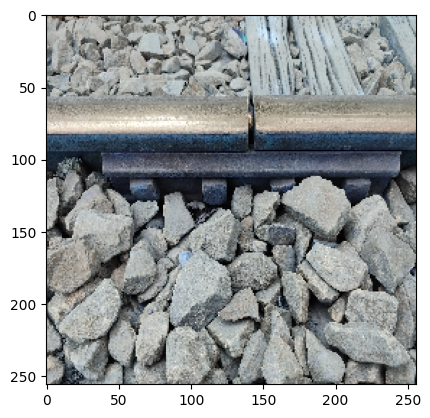

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Predicted value: Non Defective
Actual value: Non defective




Original image


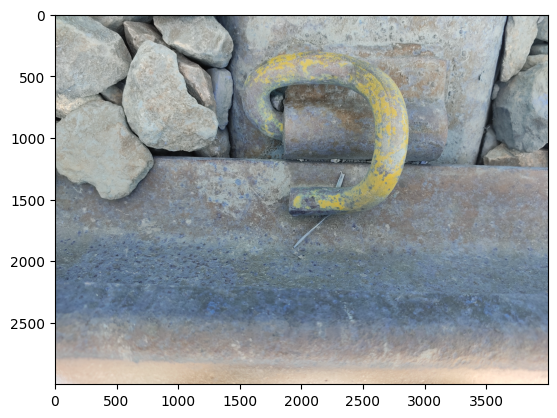

Rescaled image


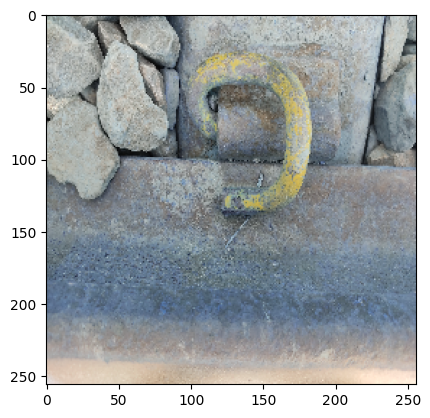

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Predicted value: Non Defective
Actual value: Non defective






In [87]:
for img in image_paths:
    testing(img)

In [88]:
from tensorflow.keras.models import load_model

In [89]:
def input_image(img_path):
    img = cv2.imread(img_path)
    img = tf.image.resize(img, (256, 256))
    plt.imshow(img.numpy().astype(int))
    plt.show()
    print("\n")
    print("\n")
    model.save(os.path.join('models', 'faulty_rail_track_classifier.h5'))
    model_cv = load_model('./models/faulty_rail_track_classifier.h5')
    output = model_cv.predict(np.expand_dims(img/255, 0))
    print(output)
    if output<0.5:
        return('DEFECTIVE')
    else:
        return('NON DEFECTIVE')

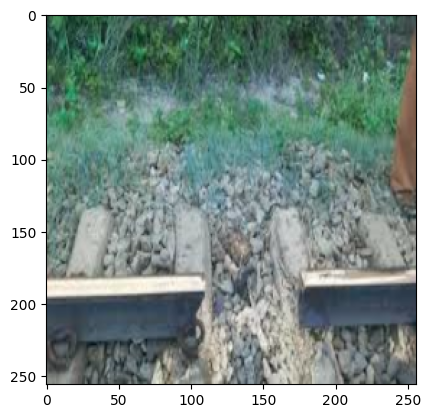

1/1 ━━━━━━━━━━━━━━━━━━━━ 9s 9s/step
[[0.0272625]]


'DEFECTIVE'

In [90]:
input_image('Broken-rail-line.jpg')